## Day 7 Project


##### Libraries


In [1]:
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
from scipy.stats import kurtosis
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import norm
from scipy.stats import kurtosis

##### Importing the Data


In [2]:
# List of all tickers
tickers = [
    "GC=F",
    "CL=F",
    "SPY",
    "AAPL",
    "GOOGL",
    "NVDA",
    "JPM",
    "GS",
    "MS",
    "RTX",
    "NOC",
    "BA",
    "GE",
    "UNP",
    "HON",
    "PLD",
    "TSLA",
    "JNJ",
    "WMT",
    "PG",
]


df = yf.download(tickers, start="2000-01-01", end="2024-12-31")["Close"]

df.head()

C:\Users\Samneh\AppData\Local\Temp\ipykernel_21876\3234123479.py:26: FutureWarning: YF.download() has changed argument auto_adjust default to True
  df = yf.download(tickers, start="2000-01-01", end="2024-12-31")["Close"]
[*********************100%***********************]  20 of 20 completed


Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Date,,,,,,,,,,,,,,,,,,,,
2000-01-03,0.840094,25.940290,NaN,NaN,129.933289,NaN,61.663677,30.331493,23.554605,23.125729,33.063690,14.034286,0.089425,27.213190,7.548298,11.412545,92.142502,NaN,6.507939,14.239621
2000-01-04,0.769266,25.899939,NaN,NaN,124.735962,NaN,57.779686,29.796442,22.692257,22.618317,30.614546,14.216770,0.087038,26.689548,7.429242,10.944629,88.539185,NaN,6.498491,13.706803
2000-01-05,0.780523,27.513632,NaN,NaN,124.519341,NaN,55.074005,29.395157,22.931789,22.478695,29.497118,14.200183,0.084172,26.181799,7.333996,10.727791,88.697578,NaN,6.498491,13.427070
2000-01-06,0.712978,27.796043,NaN,NaN,126.184158,NaN,57.430561,29.963648,23.650408,22.797832,30.063486,13.934750,0.078680,27.387737,7.476866,11.241361,87.272087,NaN,6.895196,13.573597
2000-01-07,0.746750,28.602888,NaN,NaN,131.070221,NaN,57.648750,31.568853,24.656469,23.216682,30.997232,14.266541,0.079994,29.577486,7.619736,11.686448,92.340523,NaN,6.847971,14.599275


In [3]:
df
df.dropna(how="all", inplace=True)  # Removing all non-trading days

In [4]:
# Log returns are better for the analysis as they are more normal and have less outliers
df_returns_with_zero = np.log(df / df.shift(1))

df_returns_with_zero = df_returns_with_zero.iloc[
    1:
]  # Removing the first row as it will have a NaN value

df_returns_filled = df_returns_with_zero.fillna(0)  # Filling the NaNs with 0

df_returns_with_zero.tail()

c:\Users\Samneh\Desktop\QuantDay1-14\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Date,,,,,,,,,,,,,,,,,,,,
2024-12-23,0.003060,0.001915,-0.003172,-0.006258,0.003853,0.016683,0.008233,-0.005181,0.005522,0.003319,0.008149,-0.004996,0.036232,0.000297,0.007905,0.001287,0.005970,0.022404,0.003573,-0.020703
2024-12-24,0.011413,0.009243,0.012344,0.002943,0.014508,0.007575,0.020823,0.007719,0.003985,0.016310,0.020755,0.008292,0.003930,0.004925,0.005363,0.001713,0.011054,0.070991,0.011469,0.025462
2024-12-26,0.003171,0.005782,-0.006871,0.007150,0.003841,-0.002604,-0.002680,0.012849,-0.001853,0.003419,0.007605,0.002417,-0.002070,0.007195,0.020701,0.001796,0.000067,-0.017787,0.002087,0.001186
2024-12-27,-0.013331,0.001883,0.013978,-0.008219,-0.010469,-0.014626,-0.008726,-0.010187,-0.003647,-0.008135,-0.009969,-0.001865,-0.021088,-0.003709,-0.015557,-0.002824,-0.010582,-0.050745,-0.001304,-0.012253
2024-12-30,-0.013352,-0.023345,0.005509,-0.004250,-0.011710,-0.007917,-0.004575,-0.012760,-0.011859,-0.007700,-0.008000,-0.010300,0.003497,-0.014497,-0.001331,-0.012849,-0.011477,-0.033569,-0.009351,-0.011963


In [5]:
fig = go.Figure()
kurtosis_values = []

# Loop through each ticker
for ticker in df_returns_with_zero:

    returns_data = df_returns_with_zero[
        ticker
    ].dropna()  # Dropping the NaNs, to allow the histogram to be plotted

    fig.add_trace(
        go.Histogram(
            x=returns_data,
            name="Histogram",
            histnorm="probability density",
            visible=(ticker == df_returns_with_zero.columns[0]),
        )
    )

    x_norm = np.linspace(returns_data.min(), returns_data.max(), 500)
    y_norm = norm.pdf(x_norm, returns_data.mean(), returns_data.std())

    kurtosis_values.append(kurtosis(returns_data))

    fig.add_trace(
        go.Scatter(
            x=x_norm,
            y=y_norm,
            mode="lines",
            name="Normal Dist.",
            visible=(ticker == df_returns_with_zero.columns[0]),
        )
    )

# Dropdown Menu Code
buttons = []
for i, ticker in enumerate(df_returns_with_zero.columns):
    visibility = [False] * len(fig.data)
    visibility[i * 2] = True
    visibility[i * 2 + 1] = True

    button = dict(
        label=ticker,
        method="update",
        args=[
            {"visible": visibility},
            {"title": f"Daily Log Returns Distribution: {ticker}"},
        ],
    )
    buttons.append(button)

fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top",
        )
    ],
    title_text=f"Daily Log Returns Distribution: {df_returns_with_zero.columns[0]}",
    xaxis_title="Daily Log Return",
    yaxis_title="Probability Density",
    height=600,
    bargap=0.01,
)

fig.show()

##### In a lot of these histograms, we see that the charts follow a Leptokurtosis approach, in which the peak is higher but the tails are narrow, this signifies a safer asset/commodity, whereas the riskier assets/commodities tend to have fatter tails, deviating from the normal distribution


In [6]:
i = 0
for ticker in df_returns_with_zero.columns:
    print(
        f"Kurtosis of {ticker}: {kurtosis_values[i]}"
    )  # Since default for fisher is True, it calculates the excess kurtosis, which is kurtosis - 3
    i += 1

Kurtosis of AAPL: 115.83357015178834
Kurtosis of BA: 13.893582816856423
Kurtosis of CL=F: 16.455633331387677
Kurtosis of GC=F: 5.383006837767974
Kurtosis of GE: 7.317186011768216
Kurtosis of GOOGL: 7.927055000346581
Kurtosis of GS: 12.292412144250342
Kurtosis of HON: 12.821242740802031
Kurtosis of JNJ: 14.21185432569105
Kurtosis of JPM: 14.55530240953323
Kurtosis of MS: 49.55080180468798
Kurtosis of NOC: 7.01135760044383
Kurtosis of NVDA: 12.989798669124825
Kurtosis of PG: 91.05242590010496
Kurtosis of PLD: 31.845195869360417
Kurtosis of RTX: 8.910962660013384
Kurtosis of SPY: 11.193418175515077
Kurtosis of TSLA: 4.778385977908437
Kurtosis of UNP: 5.607232960066769
Kurtosis of WMT: 8.531705413321008


##### This proves that all of them are Leptokurtic, and stocks like AAPL have extreme outliers do to major events like the dot-com bubble burst!

Kurtosis measures the extremity of the outliers, not the volatility, which is why more volatile assets are ranked lower than stocks like AAPL!


In [7]:
# Plotly and not plt as we want to plot an interactive plot
df.ffill(inplace=True)
fig = px.line(df, x=df.index, y=df.columns, title="Prices of All Assets")

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

In [8]:
import plotly.express as px

# Plotly and not plt as we want to plot an interactive plot
fig = px.line(
    df_returns_with_zero,
    x=df_returns_with_zero.index,
    y=df_returns_with_zero.columns,
    title="Daily Returns of All Assets (Interactive)",
)

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Daily Return",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

##### We tend to notice the volatility clusters here!


In [9]:
# Number of trading days in a year
trading_days = 252

# Calculate the mean daily log return for each asset
mean_log_returns = df_returns_with_zero.mean()

# Annualize the log returns
annualized_log_returns = mean_log_returns * trading_days

# Converting annualized log returns back to simple/arithmetic returns
annualized_simple_returns = np.exp(annualized_log_returns) - 1


print("--- Annualized Returns from Log Returns (2000-2024) ---")
for ticker in annualized_simple_returns.index:
    return_percentage = annualized_simple_returns[ticker] * 100
    print(f"The annualized return of {ticker:<8} is {return_percentage:>8.4f}%")

--- Annualized Returns from Log Returns (2000-2024) ---
The annualized return of AAPL     is  25.6363%
The annualized return of BA       is   8.8251%
The annualized return of CL=F     is   5.7904%
The annualized return of GC=F     is   9.4659%
The annualized return of GE       is   1.4210%
The annualized return of GOOGL    is  23.5918%
The annualized return of GS       is   9.6062%
The annualized return of HON      is   9.1559%
The annualized return of JNJ      is   7.3952%
The annualized return of JPM      is   9.9810%
The annualized return of MS       is   5.9594%
The annualized return of NOC      is  14.2559%
The annualized return of NVDA     is  34.8180%
The annualized return of PG       is   7.4529%
The annualized return of PLD      is  11.1751%
The annualized return of RTX      is  10.9388%
The annualized return of SPY      is   7.9229%
The annualized return of TSLA     is  46.8830%
The annualized return of UNP      is  15.5043%
The annualized return of WMT      is   7.7449%


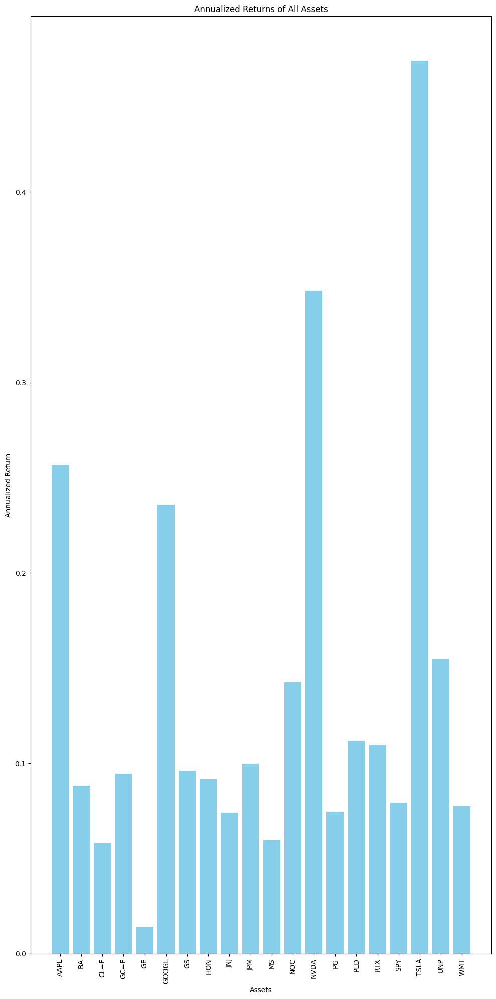

In [10]:
plt.figure(figsize=(10, 20))
plt.bar(
    annualized_simple_returns.index, annualized_simple_returns.values, color="skyblue"
)
plt.xlabel("Assets")
plt.ylabel("Annualized Return")
plt.title("Annualized Returns of All Assets")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [11]:
summary_stats = df_returns_with_zero.describe()

summary_stats_transposed = summary_stats.T

print("\n\n--- Transposed for Better Readability ---")
print(summary_stats_transposed)



--- Transposed for Better Readability ---
         count      mean       std       min       25%       50%       75%  \
Ticker                                                                       
AAPL    6284.0  0.000906  0.025251 -0.731248 -0.009855  0.000949  0.012598   
BA      6284.0  0.000336  0.022066 -0.272444 -0.009857  0.000547  0.010965   
CL=F    6096.0  0.000223  0.026012 -0.282206 -0.012694  0.001078  0.013456   
GC=F    6085.0  0.000359  0.010864 -0.098206 -0.004775  0.000459  0.006167   
GE      6284.0  0.000056  0.020862 -0.164394 -0.008784  0.000000  0.009236   
GOOGL   5123.0  0.000841  0.019173 -0.123685 -0.008034  0.000854  0.010077   
GS      6284.0  0.000364  0.022500 -0.210223 -0.009946  0.000363  0.010963   
HON     6284.0  0.000348  0.018708 -0.186454 -0.007942  0.000575  0.008710   
JNJ     6284.0  0.000283  0.012067 -0.172516 -0.005221  0.000279  0.005996   
JPM     6284.0  0.000378  0.023412 -0.232278 -0.008685  0.000318  0.009637   
MS      6284.0  0.00

In [12]:
# Making sure our stdev is annualized

stdev = df_returns_with_zero.std()

stdev = stdev * np.sqrt(trading_days)

stdev.sort_values(ascending=False)

Ticker
NVDA     0.591616
TSLA     0.571258
MS       0.458428
CL=F     0.412923
AAPL     0.400843
PLD      0.375764
JPM      0.371656
GS       0.357176
BA       0.350288
GE       0.331167
GOOGL    0.304369
HON      0.296980
UNP      0.278786
RTX      0.271222
NOC      0.251023
WMT      0.232960
PG       0.212051
SPY      0.193797
JNJ      0.191552
GC=F     0.172457
dtype: float64

##### Here we can see the volatility of all the assets, with BTC being one of the most volatile, since its the "riskiest", it makes sense for it to be one of the most rewarding


In [13]:
# here lets calculate the rolling volatility of each asset with a window of 21 days
rolling_volatility = df_returns_with_zero.rolling(window=21).std()

# lets plot the rolling volatility
fig = px.line(
    rolling_volatility,
    x=rolling_volatility.index,
    y=rolling_volatility.columns,
    title="Rolling Volatility of All Assets",
)

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Daily Return",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

#### We see 3 periods in which there were large volatlity clusters, early 2000s (Dot-com Bubble), 2008 (Financial Crisis), and 2020 (Covid-19 Recession)!


In [14]:
#  Volatility Cone
# We'll calculate volatility for windows from 1 month to 1 year
window_sizes = [21, 42, 63, 126, 252]  # Approx. 1m, 2m, 3m, 6m, 1yr

fig = go.Figure()

for ticker in df_returns_with_zero.columns:

    # Isolate the returns for the current ticker and drop its NaNs
    returns_data = df_returns_with_zero[ticker].dropna()

    # Lists to store the cone boundaries
    max_vols = []
    min_vols = []
    median_vols = []

    # Calculate boundaries for each window size
    for window in window_sizes:
        # Calculate rolling standard deviation (daily volatility)
        rolling_std = returns_data.rolling(window=window).std()

        # Annualize the daily volatility
        annualized_vol = rolling_std * np.sqrt(252)

        # Append the max, min, and median to our lists
        max_vols.append(annualized_vol.max())
        min_vols.append(annualized_vol.min())
        median_vols.append(annualized_vol.median())

    # Max Volatility Line (Top of the cone)
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=max_vols,
            mode="lines",
            line=dict(color="rgba(200, 200, 200, 0.8)"),
            name="Max Vol",
            visible=(ticker == df_returns_with_zero.columns[0]),
        )
    )

    # Min Volatility Line (Bottom of the cone, filled to the max line)
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=min_vols,
            mode="lines",
            fill="tonexty",  # This is the magic that creates the shaded cone area
            fillcolor="rgba(200, 200, 200, 0.4)",
            line=dict(color="rgba(200, 200, 200, 0.8)"),
            name="Min Vol",
            visible=(ticker == df_returns_with_zero.columns[0]),
        )
    )

    # Median Volatility Line
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=median_vols,
            mode="lines+markers",
            line=dict(color="blue", width=3),
            name="Median Vol",
            visible=(ticker == df_returns_with_zero.columns[0]),
        )
    )

buttons = []
for i, ticker in enumerate(df_returns_with_zero.columns):
    # Each ticker has 3 traces (max, min, median)
    visibility = [False] * (len(df_returns_with_zero.columns) * 3)
    visibility[i * 3] = True  # Make the i-th Max trace visible
    visibility[i * 3 + 1] = True  # Make the i-th Min trace visible
    visibility[i * 3 + 2] = True  # Make the i-th Median trace visible

    button = dict(
        label=ticker,
        method="update",
        args=[
            {"visible": visibility},
            {"title": f"Historical Volatility Cone: {ticker}"},
        ],
    )
    buttons.append(button)

# Add the dropdown and update the layout
fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top",
        )
    ],
    title_text=f"Historical Volatility Cone: {df_returns_with_zero.columns[0]}",
    xaxis_title="Time Window (Trading Days)",
    yaxis_title="Annualized Volatility",
    yaxis_tickformat=".0%",  # Format Y-axis as percentage
    height=600,
)

fig.show()

### ARIMA Forecasting


In [15]:
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller

for ticker in df_returns_with_zero.columns:
    # Check if the series is stationary
    if adfuller(df_returns_with_zero[ticker].dropna())[1] < 0.05:
        print(f"{ticker} is stationary")
    else:
        print(f"{ticker} is not stationary")

AAPL is stationary
BA is stationary
CL=F is stationary
GC=F is stationary
GE is stationary
GOOGL is stationary
GS is stationary
HON is stationary
JNJ is stationary
JPM is stationary
MS is stationary
NOC is stationary
NVDA is stationary
PG is stationary
PLD is stationary
RTX is stationary
SPY is stationary
TSLA is stationary
UNP is stationary
WMT is stationary


#### Since all of them are stationary, the ARIMA d-value is 0, however we will utilize pmdarima's auto_arima model!


In [16]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="sklearn.utils.deprecation")

import pmdarima as pm
for ticker in df_returns_with_zero.columns:
    model = pm.auto_arima(
        df_returns_with_zero[ticker].dropna(),
        start_p=1,
        start_q=1,
        test="adf",
        max_p=3,
        max_q=3,
        m=1,
        d=None,
        seasonal=False,
        start_P=0,
        D=0,
        trace=True,
        error_action="ignore",
        suppress_warnings=True,
        stepwise=True,
    )
    print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-28398.979, Time=0.66 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-28394.104, Time=0.49 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-28400.966, Time=0.52 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-28400.985, Time=0.50 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-28398.964, Time=2.33 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-28396.954, Time=1.47 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-28407.748, Time=2.02 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-28400.184, Time=1.44 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-28405.775, Time=1.16 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=-28405.749, Time=0.89 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-28407.700, Time=0.56 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-28403.788, Time=3.65 sec

Best model:  ARIMA(0,0,1)(0,0,0)[0] intercept
Total fit time: 15.791 seconds
                               SARIMAX Results                 

##### Covariance & Correlation


In [17]:
cov_matrix = (
    df_returns_with_zero.cov() * trading_days
)  # Making sure the covariance is annualized

cov_matrix.head()

cov_matrix.style.background_gradient(cmap="coolwarm")

Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Ticker,,,,,,,,,,,,,,,,,,,,
AAPL,0.160675,0.040144,0.015355,-0.001098,0.044406,0.051079,0.053343,0.041205,0.016604,0.051813,0.066089,0.022031,0.097561,0.016298,0.043652,0.035548,0.042554,0.057023,0.035123,0.023354
BA,0.040144,0.122702,0.023468,0.000752,0.057121,0.039632,0.055316,0.055667,0.021295,0.057792,0.070260,0.037408,0.057181,0.020083,0.048485,0.056892,0.040383,0.057861,0.043636,0.021553
CL=F,0.015355,0.023468,0.170506,0.013558,0.019892,0.017945,0.023897,0.017220,0.004838,0.020635,0.030175,0.012407,0.025245,0.004710,0.018928,0.017616,0.017829,0.031479,0.022402,-0.000940
GC=F,-0.001098,0.000752,0.013558,0.029741,-0.002154,0.000330,-0.002866,-0.000704,-0.000767,-0.005182,-0.004681,-0.000033,0.000271,-0.000128,0.002491,-0.000467,-0.000065,0.004276,0.000422,-0.001628
GE,0.044406,0.057121,0.019892,-0.002154,0.109671,0.035429,0.061956,0.053270,0.021229,0.071790,0.079389,0.027687,0.062561,0.021322,0.055791,0.049565,0.042406,0.041294,0.042051,0.024009
GOOGL,0.051079,0.039632,0.017945,0.000330,0.035429,0.092641,0.046696,0.034999,0.017047,0.045073,0.058977,0.021183,0.066763,0.017034,0.048966,0.031691,0.036397,0.052015,0.033801,0.017590
GS,0.053343,0.055316,0.023897,-0.002866,0.061956,0.046696,0.127575,0.053496,0.021364,0.096236,0.134189,0.029807,0.080610,0.019084,0.063420,0.048172,0.049522,0.045973,0.048720,0.026441
HON,0.041205,0.055667,0.017220,-0.000704,0.053270,0.034999,0.053496,0.088197,0.021437,0.057864,0.069490,0.032290,0.059444,0.021191,0.046158,0.050846,0.039553,0.035809,0.043654,0.022904
JNJ,0.016604,0.021295,0.004838,-0.000767,0.021229,0.017047,0.021364,0.021437,0.036692,0.023345,0.030674,0.018104,0.015848,0.018644,0.022908,0.020386,0.019203,0.012695,0.018106,0.015291


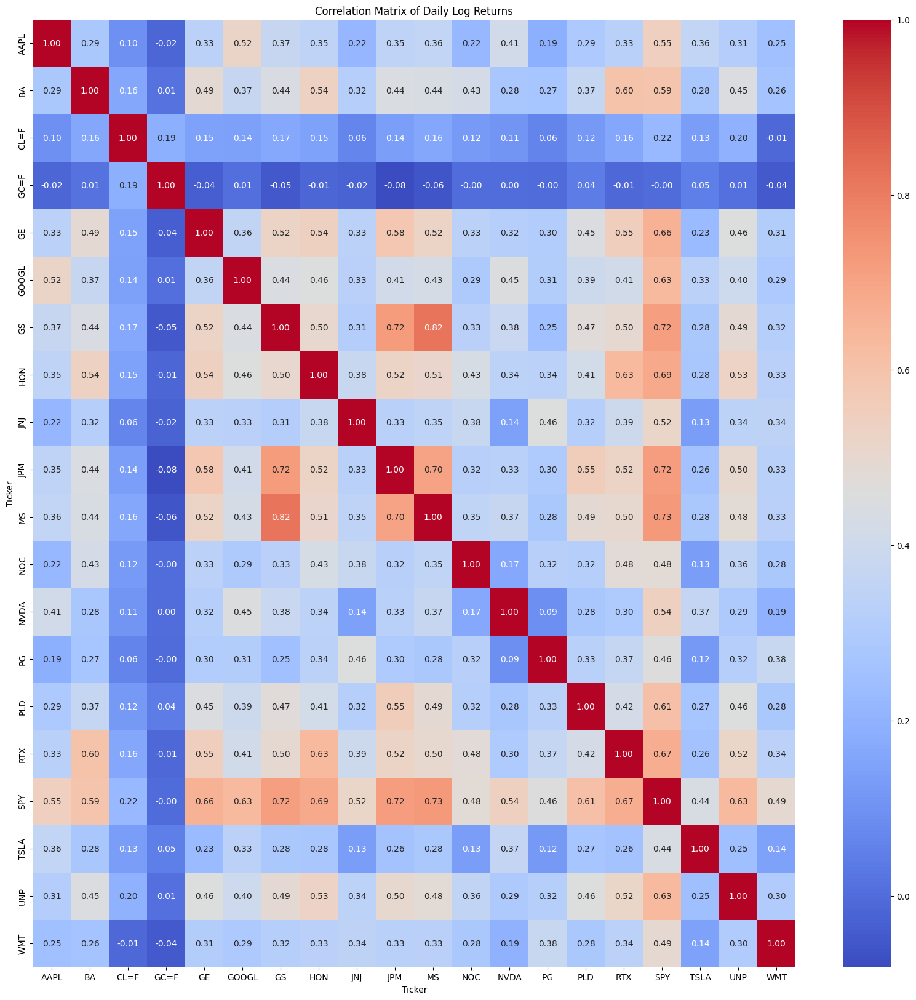

In [18]:
import seaborn as sns

plt.figure(figsize=(20, 20))
sns.heatmap(df_returns_with_zero.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix of Daily Log Returns")
plt.show()